In [1]:
import pandas as pd
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
import numpy as np
import os
import matplotlib.pyplot as plt

from dtaidistance import clustering
from dtaidistance import dtw
import scipy

import folium

from statsmodels.tsa.statespace.sarimax import SARIMAXResults
from sklearn.linear_model import LinearRegression
from scipy import stats
import statsmodels.api as sm

from itertools import product
import itertools

from catboost import CatBoostRegressor

from sklearn.metrics import mean_squared_error, mean_absolute_error

In [2]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\magics\pylab.py:160: UserWarning: pylab import has clobbered these variables: ['product']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


# Загружаем данные

In [3]:
data_all = pd.read_csv('../data/cross_date_reg_2016-01_2016_06.csv', index_col=0)
data_all.index = pd.to_datetime(data_all['tpep_pickup_datetime'], errors='coerce', format="%Y-%m-%d %H:%M:%S")
data_all.drop(columns='tpep_pickup_datetime', inplace=True)

In [4]:
data_all

,1,2,3,4,5,6,7,8,9,10,...,2491,2492,2493,2494,2495,2496,2497,2498,2499,2500
tpep_pickup_datetime,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-01-01 01:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-01-01 02:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-01-01 03:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-01-01 04:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-06-30 19:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-06-30 20:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-06-30 21:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
mean_rides_cell_more_5 = pd.read_csv('../data/mean_rides_cell_more_5.csv', index_col=0)
data_102_reg = data_all[[str(reg) for reg in mean_rides_cell_more_5.region.values]]
data_102_reg

,1075,1076,1077,1125,1126,1127,1128,1129,1130,1131,...,1630,1684,1733,1734,1783,2068,2069,2118,2119,2168
tpep_pickup_datetime,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,80,144,50,77,319,402,531,617,846,267,...,12,0,2,44,5,41,4,70,7,66
2016-01-01 01:00:00,91,211,49,134,404,420,370,453,594,224,...,29,0,5,2,2,4,0,47,1,29
2016-01-01 02:00:00,90,146,23,110,393,425,313,366,377,138,...,47,0,3,0,4,0,0,69,1,14
2016-01-01 03:00:00,32,87,16,62,252,399,324,309,327,166,...,46,0,2,4,5,1,0,21,0,9
2016-01-01 04:00:00,24,43,10,53,145,254,264,333,318,145,...,43,0,0,1,1,0,0,26,1,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-06-30 19:00:00,116,190,135,132,395,308,401,336,496,260,...,2,44,4,297,311,104,9,142,96,1
2016-06-30 20:00:00,104,142,149,141,333,368,390,385,560,247,...,1,27,7,288,344,103,24,209,145,0
2016-06-30 21:00:00,151,162,145,135,359,422,460,541,672,259,...,2,21,9,287,307,185,9,213,142,1


# Формируем признаки для регрессии

Получим номер кластера для каждого региона с прошлой недели

In [6]:
cluster = np.array([2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 3, 4, 4, 4, 4, 2, 3, 2, 2, 2, 1, 1,
       4, 1, 3, 3, 4, 4, 4, 3, 3, 2, 2, 2, 2, 2, 2, 2, 3, 4, 3, 4, 1, 1,
       2, 2, 2, 2, 2, 2, 1, 3, 3, 1, 1, 1, 2, 1, 1, 1, 2, 4, 3, 3, 3, 4,
       2, 1, 1, 1, 1, 4, 4, 4, 4, 3, 4, 1, 4, 4, 4, 4, 4, 4, 4, 4, 3, 4,
       4, 3, 3, 4, 3, 2, 4, 2, 2, 2, 2, 2, 2, 2])

In [7]:
reg_cl = {}
for i in range(0, cluster.shape[0]):
    reg_cl[data_102_reg.columns[i]] = cluster[i]

Гармоники для недельной сезонности

In [8]:
sin_cos_cols = []
for i in range(1, 22):
    data_102_reg['cy%d'%i] = np.cos(np.arange(data_102_reg.shape[0]) * 2.0 * np.pi * i / 168)
    data_102_reg['sy%d'%i] = np.sin(np.arange(data_102_reg.shape[0]) * 2.0 * np.pi * i / 168)
    sin_cos_cols += ['cy%d'%i, 'sy%d'%i]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [21]:
K = 6 # количество поездок в предидущие моментов времени
Kd = 2 # количество поездок в предидущие сезоные меоменты времени (день)
Kw = 2 # количество поездок в предидущие сезоные меоменты времени (неделя)
predict_hours = 6 # количество предсказываемых часов

In [26]:
%%time
data_train = []
labels = []
for reg in data_102_reg.columns[:102]:
    cl = reg_cl[reg]
    print("Регион: %s, кластер: %d" % (reg, cl))
    # цикл по часам
    for ti in data_102_reg.iloc[24 * 7 * Kw:-predict_hours].index:
        # id, регион, кластер, месяц, день месяца, день недели, выходной
        row = ["%s_%s_%d" % (reg, str(ti.date()), ti.hour),
               reg, cl, ti.month, ti.day, ti.hour, ti.weekday(), 
               int((ti.weekday() == 5) | (ti.weekday() == 6))]
        # количество поездок в предидущие K моментов времени
        row.extend(data_102_reg.loc[ti - relativedelta(hours=K-1):ti][reg].to_list())
        # количество поездок в предидущие Kd сезоных меомента времени (день)
        for i in range(1, Kd+1):
            row.append(data_102_reg.loc[ti - relativedelta(hours=i * 24)][reg])
        # количество поездок в предидущие Kw сезоных меомента времени (неделя)
        for i in range(1, Kw+1):
            row.append(data_102_reg.loc[ti - relativedelta(hours=i * 24 * 7)][reg])
        # гармоники для недельной сезонности
        row.extend(data_102_reg.loc[ti][sin_cos_cols].to_list())
        # суммарное количество поездок из рассматриваемого района за предшествующие полдня, сутки
        row.append(data_102_reg.loc[ti-relativedelta(hours=12):ti][reg].sum())
        row.append(data_102_reg.loc[ti-relativedelta(hours=24):ti][reg].sum())
        data_train.append(row)
        labels.append(data_102_reg.loc[ti+relativedelta(hours=1):ti+relativedelta(hours=predict_hours)][reg].values)

Регион: 1075, кластер: 2
Регион: 1076, кластер: 2
Регион: 1077, кластер: 1
Регион: 1125, кластер: 2
Регион: 1126, кластер: 2
Регион: 1127, кластер: 2
Регион: 1128, кластер: 2
Регион: 1129, кластер: 2
Регион: 1130, кластер: 2
Регион: 1131, кластер: 2
Регион: 1132, кластер: 3
Регион: 1172, кластер: 4
Регион: 1173, кластер: 4
Регион: 1174, кластер: 4
Регион: 1175, кластер: 4
Регион: 1176, кластер: 2
Регион: 1177, кластер: 3
Регион: 1178, кластер: 2
Регион: 1179, кластер: 2
Регион: 1180, кластер: 2
Регион: 1181, кластер: 1
Регион: 1182, кластер: 1
Регион: 1183, кластер: 4
Регион: 1184, кластер: 1
Регион: 1221, кластер: 3
Регион: 1222, кластер: 3
Регион: 1223, кластер: 4
Регион: 1224, кластер: 4
Регион: 1225, кластер: 4
Регион: 1227, кластер: 3
Регион: 1228, кластер: 3
Регион: 1229, кластер: 2
Регион: 1230, кластер: 2
Регион: 1231, кластер: 2
Регион: 1232, кластер: 2
Регион: 1233, кластер: 2
Регион: 1234, кластер: 2
Регион: 1235, кластер: 2
Регион: 1272, кластер: 3
Регион: 1273, кластер: 4


In [138]:
cols = ['id', 'region', 'cluster', 'month', 'day', 'hour', 'weekday', 'weekend']
for i in range(K-1, -1, -1):
    cols.append('T-%d'%i)
for i in range(1, Kd+1):
    cols.append('T-%d'%(i*24))
for i in range(1, Kw+1):
    cols.append('T-%d'%(i*24*7))
cols.extend(sin_cos_cols)
cols.append('sum12')
cols.append('sum24')

In [11]:
#data_train_df = pd.read_csv('../data/week5.csv', index_col=0)
#labels_df = pd.read_csv('../data/lab_week5.csv', index_col=0)

In [155]:
#data_train_df.to_csv('../data/data_train_week5.csv')
#labels_df.to_csv('../data/labels_week5.csv')

In [139]:
data_train_df = pd.DataFrame(data_train, columns=cols)

In [156]:
labels_df = pd.DataFrame(labels, columns=['h%d' % x for x in range(1, predict_hours+1)])

### Разбиваем полученные признаки на обучение (до апреля включительно), тест (май) и итог (июнь)

In [145]:
X_train = data_train_df.drop(columns=['id'])[data_train_df['month'] < 5]
X_test = data_train_df.drop(columns=['id'])[(data_train_df['month'] > 4) & (data_train_df['month'] < 6)]
X_valid = data_train_df.drop(columns=['id'])[data_train_df['month'] > 5]

In [146]:
X_train.month.unique()

array([1, 2, 3, 4], dtype=int64)

In [150]:
X_test.month.unique()

array([5], dtype=int64)

In [151]:
X_valid.month.unique()

array([6], dtype=int64)

In [152]:
y_train = labels_df.loc[X_train.index]
y_test = labels_df.loc[X_test.index]
y_valid = labels_df.loc[X_valid.index]

In [153]:
(X_train.shape[0] + X_test.shape[0] + X_valid.shape[0]) == data_train_df_2.shape[0]

True

In [154]:
(y_train.shape[0] + y_test.shape[0] + y_valid.shape[0]) == labels_df.shape[0]

True

# Обучение моделей

Будем использовать CatBoost от Yandex - алгоритм градиентного бустинга. Данный алгоритм позволяет работать как с численными признаками, так и с категориальными.

Зададим какие из признаков являются категориальными

In [46]:
cat_features = ['region', 'cluster', 'month', 'day', 'hour', 'weekday', 'weekend']

Дефолтные параметры в CatBoost часто дают довольно хороший результат. Попробуем обучить на дефолтных параметрах, попробуем подбор параметров и сравним результаты.

In [157]:
model_def = CatBoostRegressor(cat_features=cat_features)
model_def.fit(X_train, y=y_train['h1'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h1']))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [158]:
mean_absolute_error(y_test['h1'], model_def.predict(X_test))

16.74846282001583

Попробуем подобрать скорость обучения (learning rate), глубину деревьев (depth) и коэффициент l2 регуляризации.

In [61]:
learniong_rate = [0.03, 0.1]
depth = [6, 10]
l2_leaf_reg = [1, 3, 5, 7, 9]

In [161]:
results = []
for lr in learniong_rate:
    for d in depth:
        for l2 in l2_leaf_reg:
            model = CatBoostRegressor(learning_rate=lr, depth=d, l2_leaf_reg=l2, cat_features=cat_features)
            model.fit(X_train, y=y_train['h1'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h1']))
            res = mean_absolute_error(y_test['h1'], model.predict(X_test))
            print("learniong_rate: %f, depth: %d, l2: %d, score: %f" % (lr, d, l2, res))
            results.append([[lr, d, l2], model, res])

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 6, l2: 1, score: 17.909387


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 6, l2: 3, score: 18.057336


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 6, l2: 5, score: 17.930011


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 6, l2: 7, score: 17.988434


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 6, l2: 9, score: 18.079841


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 10, l2: 1, score: 16.292752


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 10, l2: 3, score: 16.267532


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 10, l2: 5, score: 16.343001


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 10, l2: 7, score: 16.478997


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.030000, depth: 10, l2: 9, score: 16.497427


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 6, l2: 1, score: 16.769106


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 6, l2: 3, score: 18.993648


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 6, l2: 5, score: 17.127807


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 6, l2: 7, score: 16.837363


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 6, l2: 9, score: 17.177926


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 10, l2: 1, score: 16.176148


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 10, l2: 3, score: 15.893200


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 10, l2: 5, score: 15.794761


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 10, l2: 7, score: 15.947584


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

learniong_rate: 0.100000, depth: 10, l2: 9, score: 16.056871


In [163]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'model', 'score']
print(result_table[['parameters', 'score']].sort_values(by = 'score', ascending=True).head())

      parameters      score
17  [0.1, 10, 5]  15.794761
16  [0.1, 10, 3]  15.893200
18  [0.1, 10, 7]  15.947584
19  [0.1, 10, 9]  16.056871
15  [0.1, 10, 1]  16.176148


In [168]:
model1 = result_table.iloc[17].model

Подбор параметров дал результат лучше, чем дефолтная модель. Параметры модели с наименьшей ошибкой: learning rate = 0.1, depth = 10, l2 = 5. Обучим модели для предсказания следующих часов с выбранными гиперпараметрами.

In [169]:
model2 = CatBoostRegressor(learning_rate=0.1, depth=10, l2_leaf_reg=5, cat_features=cat_features)
model2.fit(X_train, y=y_train['h2'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h2']))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [170]:
mean_absolute_error(y_test['h2'], model2.predict(X_test))

19.634732271577136

In [171]:
model3 = CatBoostRegressor(learning_rate=0.1, depth=10, l2_leaf_reg=5, cat_features=cat_features)
model3.fit(X_train, y=y_train['h3'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h3']))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [172]:
mean_absolute_error(y_test['h3'], model3.predict(X_test))

21.143124710966426

In [173]:
model4 = CatBoostRegressor(learning_rate=0.1, depth=10, l2_leaf_reg=5, cat_features=cat_features)
model4.fit(X_train, y=y_train['h4'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h4']))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [174]:
mean_absolute_error(y_test['h4'], model4.predict(X_test))

22.176145916188148

In [175]:
model5 = CatBoostRegressor(learning_rate=0.1, depth=10, l2_leaf_reg=5, cat_features=cat_features)
model5.fit(X_train, y=y_train['h5'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h5']))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [176]:
mean_absolute_error(y_test['h5'], model5.predict(X_test))

24.64614884582994

In [177]:
model6 = CatBoostRegressor(learning_rate=0.1, depth=10, l2_leaf_reg=5, cat_features=cat_features)
model6.fit(X_train, y=y_train['h6'], logging_level='Silent', plot=True, eval_set=(X_test, y_test['h6']))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [178]:
mean_absolute_error(y_test['h6'], model6.predict(X_test))

23.544692879575578

### Выбранными моделями построим для каждой географической зоны и каждого конца истории от 2016.04.30 23:00 до 2016.05.31 17:00 прогнозы на 6 часов вперёд; посчитаем ошибку прогноза

Создадим DataFrame с необходимым диапозоном времени.

In [179]:
%%time
datetime_list = []
id_list = []
for reg in data_102_reg.columns[:102]:
    # цикл по часам
    for ti in data_102_reg.iloc[24 * 7 * Kw:-predict_hours].index:
        datetime_list.append(ti)
        id_list.append("%s_%s_%d" % (reg, str(ti.date()), ti.hour))

Wall time: 1.97 s


In [185]:
data_train_df['datetime'] = datetime_list

In [190]:
data_may = data_train_df[(data_train_df['datetime'] >= '2016-04-30 23:00') & (data_train_df['datetime'] <= '2016-05-31 17:00')]

In [191]:
labels_may = labels_df.loc[data_may.index]

На выбранных данных сделаем предсказания построенными моделями

In [259]:
res1 = pd.DataFrame(model1.predict(data_may.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_may.index].id + "_1", 
                    columns=['y'])
res2 = pd.DataFrame(model2.predict(data_may.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_may.index].id + "_2", 
                    columns=['y'])
res3 = pd.DataFrame(model3.predict(data_may.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_may.index].id + "_3", 
                    columns=['y'])
res4 = pd.DataFrame(model4.predict(data_may.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_may.index].id + "_4", 
                    columns=['y'])
res5 = pd.DataFrame(model5.predict(data_may.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_may.index].id + "_5", 
                    columns=['y'])
res6 = pd.DataFrame(model6.predict(data_may.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_may.index].id + "_6", 
                    columns=['y'])

In [265]:
forecast_may = res1.append(res2.append(res3.append(res4.append(res5.append(res6)))))
true_rides_may = labels_may['h1'].append(labels_may['h2'].append(labels_may['h3'].append(labels_may['h4'].append(labels_may['h5'].append(labels_may['h6'])))))
true_rides_may.index = forecast_may.index
res_may = forecast_may
res_may['labels'] = true_rides_may

In [271]:
print("Ошибка прогноза за май: %f" % (res_may['y'] - res_may['labels']).abs().mean())

Ошибка прогноза за май: 21.185833


На предидущей недели модели ARIMA строили прогнозы с ошибкой 25.537716990905412, применение регрессионной модели позволило улучшить результат.

In [273]:
res_may.to_csv('../data/res_may_week5.csv')

Теперь посторим прогнозы для июня, сохраним их в файл и загрузим на Kaggle

In [274]:
data_june = data_train_df[(data_train_df['datetime'] >= '2016-05-31 23:00') & (data_train_df['datetime'] <= '2016-06-30 17:00')]

In [275]:
labels_june = labels_df.loc[data_june.index]

In [276]:
res1 = pd.DataFrame(model1.predict(data_june.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_june.index].id + "_1", 
                    columns=['y'])
res2 = pd.DataFrame(model2.predict(data_june.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_june.index].id + "_2", 
                    columns=['y'])
res3 = pd.DataFrame(model3.predict(data_june.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_june.index].id + "_3", 
                    columns=['y'])
res4 = pd.DataFrame(model4.predict(data_june.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_june.index].id + "_4", 
                    columns=['y'])
res5 = pd.DataFrame(model5.predict(data_june.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_june.index].id + "_5", 
                    columns=['y'])
res6 = pd.DataFrame(model6.predict(data_june.drop(columns=['id', 'datetime'])), 
                    index=data_train_df.loc[data_june.index].id + "_6", 
                    columns=['y'])

In [277]:
forecast_june = res1.append(res2.append(res3.append(res4.append(res5.append(res6)))))
true_rides_june = labels_june['h1'].append(labels_june['h2'].append(labels_june['h3'].append(labels_june['h4'].append(labels_june['h5'].append(labels_june['h6'])))))
true_rides_june.index = forecast_june.index
res_june = forecast_june
res_june['labels'] = true_rides_june

In [282]:
print("Ошибка прогноза за июнь: %f" % (res_june['y'] - res_june['labels']).abs().mean())

Ошибка прогноза за июнь: 20.949279


In [281]:
forecast_june[['y']].to_csv('../data/forecast_june_week5.csv')

Загружаем полученный результат на Kaggle. Вот скриншот сабмита:

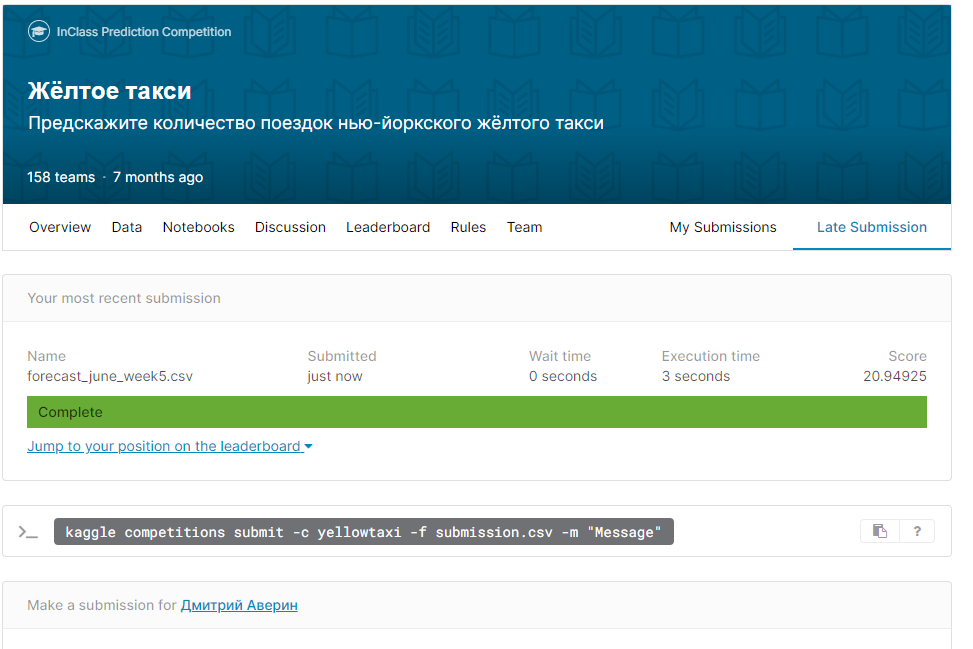

In [284]:
from IPython.display import Image
Image("2020-07-20_21-42-05.png")

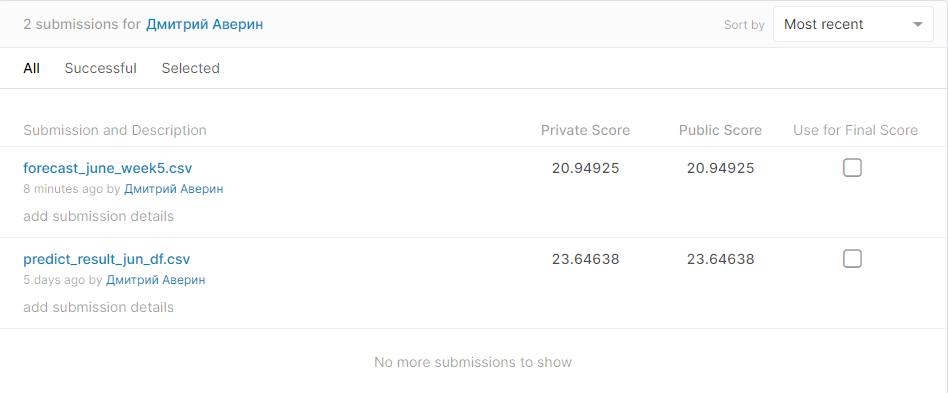

In [285]:
from IPython.display import Image
Image("2020-07-20_21-49-14.png")

Как видно по последнему скриншоту, результат на данных за июнь так же улучшился по сравнению с результатами предидущей недели.